In [1]:
# !pip install pytz
# !pip install networkx
# !pip install pyyaml
# !pip3 install torch torchvision torchaudio --extra-index-url https://download.pytorch.org/whl/cu116

In [2]:
import os
import logging
from pytz import timezone
from datetime import datetime
import numpy as np

from helpers.log_helper import LogHelper
from helpers.tf_utils import set_seed
from helpers.dir_utils import create_dir
from helpers.analyze_utils import count_accuracy, plot_estimated_graph


In [3]:
import pandas as pd
import pickle

filter_col = ['total_rx_lag1']

headers = pd.read_csv('../datasets/takeda_fix.csv', nrows=0).columns.tolist()

# filter column
headers = [i for i in headers if i not in filter_col]

X = pd.read_csv("../datasets/takeda.csv", usecols=headers)

In [4]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import make_column_transformer

category_col = 'seasonality'
category_idx = headers.index('seasonality')


onehot = OneHotEncoder()
group_data = onehot.fit_transform(X[[category_col]]).toarray()
col_names = onehot.get_feature_names(input_features=["seasonality"])
group_data = pd.DataFrame(group_data, columns=col_names)

X = pd.concat([X, group_data], axis=1)

In [5]:
from sklearn.preprocessing import LabelEncoder
labelencoder = LabelEncoder()

non_numeric_columns = list(X.select_dtypes(exclude=[np.number]).columns)

for col in non_numeric_columns:
    X[col] = labelencoder.fit_transform(X[col])
X

,total_rx,trend,seasonality,state,consumer_adherence_program_taccess_alazzo_klick_emails.sent_email,consumer_adheris_in_home.print,consumer_adheris_in_pharmacy.print,consumer_branded_crm.sent_email,consumer_branded_facebook.impressions,consumer_branded_website.sessions,...,seasonality_December,seasonality_February,seasonality_January,seasonality_July,seasonality_June,seasonality_March,seasonality_May,seasonality_November,seasonality_October,seasonality_September
0,141.33924,0,10,0,0,0,99,0,0,381,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,1889.34232,0,10,1,0,0,649,0,0,4427,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,554.40478,0,10,2,0,0,214,0,0,2223,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,1057.52366,0,10,3,0,0,658,0,0,4596,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,6128.38954,0,10,4,0,0,1305,0,0,34189,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2486,127.31752,46,1,48,7,0,0,3,51880,540,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2487,1801.09856,46,1,49,130,0,0,42,252112,10229,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2488,1729.85302,46,1,50,116,0,0,36,487969,6251,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2489,1256.02264,46,1,51,117,0,0,51,393289,1960,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [6]:
filter_col = ['seasonality']
X = X.drop(columns=filter_col, axis=1)
X

,total_rx,trend,state,consumer_adherence_program_taccess_alazzo_klick_emails.sent_email,consumer_adheris_in_home.print,consumer_adheris_in_pharmacy.print,consumer_branded_crm.sent_email,consumer_branded_facebook.impressions,consumer_branded_website.sessions,consumer_disease_state_lighter_blue_crm.sent_email,...,seasonality_December,seasonality_February,seasonality_January,seasonality_July,seasonality_June,seasonality_March,seasonality_May,seasonality_November,seasonality_October,seasonality_September
0,141.33924,0,0,0,0,99,0,0,381,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,1889.34232,0,1,0,0,649,0,0,4427,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,554.40478,0,2,0,0,214,0,0,2223,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,1057.52366,0,3,0,0,658,0,0,4596,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,6128.38954,0,4,0,0,1305,0,0,34189,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2486,127.31752,46,48,7,0,0,3,51880,540,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2487,1801.09856,46,49,130,0,0,42,252112,10229,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2488,1729.85302,46,50,116,0,0,36,487969,6251,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2489,1256.02264,46,51,117,0,0,51,393289,1960,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [7]:
# Setup for logging
output_dir = 'output/{}'.format(datetime.now(timezone('Asia/Taipei')).strftime('%Y-%m-%d_%H-%M-%S-%f')[:-3])
create_dir(output_dir)
LogHelper.setup(log_path='{}/training.log'.format(output_dir), level_str='INFO')
_logger = logging.getLogger(__name__)
print(output_dir)

headers = list(X.columns)

X = X.to_numpy()

_logger.info('Finished generating dataset')

X.shape

2022-07-07 23:23:38,535 INFO - helpers.log_helper - Finished configuring logger.
2022-07-07 23:23:38,537 INFO - __main__ - Finished generating dataset


output/2022-07-08_12-23-38-535


(2491, 67)

In [8]:
!nvidia-smi

Fri Jul  8 04:23:38 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.08    Driver Version: 510.73.08    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ...  On   | 00000000:01:00.0 Off |                  N/A |
|  0%   36C    P8    16W / 190W |   1927MiB /  6144MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [9]:
dim_of_x = X.shape[1]
dim_of_y = X.shape[0]
dim_of_x, dim_of_y

(67, 2491)

In [10]:
with open('x.pkl', 'wb') as handle:
    pickle.dump(X[..., np.newaxis], handle, protocol=pickle.HIGHEST_PROTOCOL)

In [11]:
Y = np.zeros([dim_of_x, dim_of_x])
Y.shape

(67, 67)

In [12]:
from train import predict

True
Namespace(batch_size=100, c_A=1, cuda=False, data_dir='.', data_filename='x.pkl', data_sample_size=2491, data_type='discrete', data_variable_size=67, decoder='mlp', decoder_dropout=0.0, decoder_hidden=64, dynamic_graph=False, edge_types=2, encoder='mlp', encoder_dropout=0.0, encoder_hidden=64, epochs=30, factor=True, gamma=1.0, graph_degree=2, graph_linear_type='nonlinear_2', graph_sem_type='linear-gauss', graph_threshold=0.3, graph_type='erdos-renyi', h_tol=1e-08, hard=False, k_max_iter=100.0, lambda_A=0.0, load_folder='', lr=0.003, lr_decay=200, no_cuda=True, no_factor=False, optimizer='Adam', prediction_steps=10, prior=False, save_folder='logs', seed=42, skip_first=False, suffix='_springs5', tau_A=0.0, temp=0.5, use_A_connect_loss=0, use_A_positiver_loss=0, var=5e-05, x_dims=1, z_dims=1)
./x.pkl
(2491, 67, 1)


In [13]:
result = predict(epochs=300, k_max_iter=1, c_A=1)

c_A 1


  0%|          | 0/300 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/torch/optim/lr_scheduler.py:134: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  "https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate", UserWarning)
/usr/local/lib/python3.6/dist-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/usr/local/lib/python3.6/dist-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
100%|██████████| 300/300 [01:07<00:00,  4.45it/s]

Accuracy: fdr 0.9828496042216359  tpr  0.16666666666666666  fpr  0.3492733239568683 shd 796 nnz 758


In [14]:
# w_est = result[0][0]
w_est = result
w_est

array([[ 0.        ,  0.41238851,  0.        , ...,  0.        ,
         0.45514105,  0.53364308],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [ 0.        , -0.35331498,  0.        , ..., -0.32328855,
        -0.3376919 , -0.31021045],
       ...,
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ]])

In [15]:
# Save raw estimated graph, ground truth and observational data after training
np.save('{}/X.npy'.format(output_dir), X)
np.save('{}/Y.npy'.format(output_dir), Y)
np.save('{}/final_raw_estimated_graph.npy'.format(output_dir), w_est)

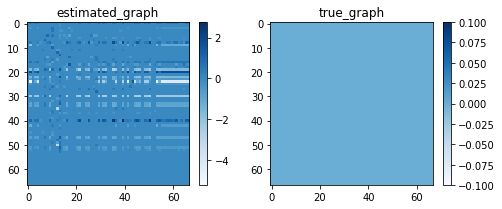

2022-07-07 23:24:47,212 INFO - __main__ - Results: {'fdr': 1.0, 'tpr': 0.0, 'fpr': 0.34283129805517865, 'shd': 753, 'pred_size': 758}


In [16]:
# Plot raw estimated graph
plot_estimated_graph(w_est, Y,
                     save_name='{}/raw_estimated_graph.png'.format(output_dir))

results_thresholded = count_accuracy(Y, w_est)
_logger.info('Results: {}'.format(results_thresholded))

In [17]:
y_idx = headers.index('total_rx')
y_idx

filter_w = w_est
print(filter_w.shape)

del_indexes = []
for x in range(filter_w.shape[0]):
    if abs(filter_w[y_idx, x]) <= 0.0 and x != y_idx:
        del_indexes.append(x)
        
        
print(del_indexes, len(del_indexes))
filter_w = np.delete(filter_w, del_indexes, 0)
filter_w = np.delete(filter_w, del_indexes, 1)

filter_headers = list(np.delete(headers, del_indexes))

filter_w.shape

(67, 67)
[2, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 16, 17, 18, 19, 20, 22, 23, 24, 26, 27, 28, 30, 33, 34, 37, 38, 40, 41, 42, 43, 47, 51, 52, 55, 56, 62, 63, 64] 39


(28, 28)

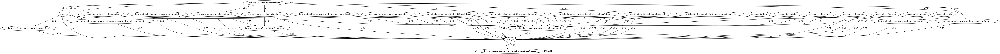

In [20]:
from lingam.utils import make_dot

dot = make_dot(filter_w, 
               labels=filter_headers
              )

# Save png
dot.format = 'png'
dag_path = dot.render('{}/total_rx'.format(output_dir))

from IPython.display import Image
Image(filename=dag_path) 

In [21]:
from lingam.utils import make_dot

dot = make_dot(w_est, 
               labels=headers
              )

# Save png
dot.format = 'png'
dag_path = dot.render('{}/full'.format(output_dir))

from IPython.display import Image
Image(filename=dag_path) 